# Crime Statistics in NSW (2014-2018)
#### Ticklepizza

### Initial Goals of the project
Look at the crimes statistics of NSW between 2014 and 2018
- Identify if there are any notable trends during the year. IE. Seasonal offenders
- Identify the highest crime areas and the most crimes committed there

In [1]:
import os
import geopandas as gp
import shapely
import fiona
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import xlrd


shp_file_name = "NSW_LOCALITY_POLYGON_shp/NSW_LOCALITY_POLYGON_shp.shp"
zip_file_name = "nsw_locality_polygon_shp.zip"
web_file_path = ("https://data.gov.au/dataset/91e70237-d9d1-4719-a82f-e71b811154c6/resource/"
                 "5e295412-357c-49a2-98d5-6caf099c2339/download/nsw_locality_polygon_shp.zip")

data_file_name = "SuburbData2018.csv"
data_zip_name = "SuburbData.zip"
web_data_path = "https://www.bocsar.nsw.gov.au/Documents/Datasets/SuburbData.zip"

In [2]:
%matplotlib inline
plt.rcParams['figure.figsize'] = (20, 10)

In [3]:
def unzip_zipfile(zipped_file_path, put_it_here="."):
    import zipfile
    zip_of_suburbs = zipfile.ZipFile(zipped_file_path, 'r')
    zip_of_suburbs.extractall(put_it_here)
    zip_of_suburbs.close()

In [4]:
# Get the data loaded. This is a bit complicated because it's online as a zip file.
# If we don't have it right now, we need to get it and unzip it.
if os.path.isfile(shp_file_name):
    print("loading from file")
else:
    if os.path.isfile(zip_file_name):
        print("unzipping")
        unzip_zipfile(zip_file_name)
    else:
        import requests
        print("loading from the internet")
        page = requests.get(web_file_path)
        with open(zip_file_name, 'wb') as z:
            z.write(page.content)
        unzip_zipfile(zip_file_name)

print("done")

loading from file
done


In [5]:
# Get the data loaded. This is a bit complicated because it's online as a zip file.
# If we don't have it right now, we need to get it and unzip it.
if os.path.isfile(data_file_name):
    print("loading from file")
else:
    if os.path.isfile(data_zip_name):
        print("unzipping")
        unzip_zipfile(data_zip_name)
    else:
        import requests
        print("loading from the internet")
        page = requests.get(web_data_path)
        with open(data_zip_name, 'wb') as z:
            z.write(page.content)
        unzip_zipfile(data_zip_name)
        
print("done")

loading from file
done


## Plan:
- [ ] Delete all data before 2014
- [ ] Combine each subcategory into their offence category
- [ ] Look at trends of crime per suburbs
- [ ] Look at trends of crime around the year
- [ ] Look at whether location also affects offence category


In [6]:
burbs = gp.GeoDataFrame.from_file(shp_file_name)
burbs.drop(["NSW_LOCA_1", "NSW_LOCA_3", "NSW_LOCA_4", "NSW_LOCA_5", "DT_RETIRE", "DT_CREATE", "NSW_LOCA_6", "LC_PLY_PID", "LOC_PID","NSW_LOCALI","NSW_LOCA_7"], axis=1, inplace=True)
burbs.rename(columns = {"NSW_LOCA_2": "Suburb"},inplace = True)
burbs.head(5)

,Suburb,geometry
0,MAYFIELD WEST,"POLYGON ((151.73344571654 -32.87974104891, 151..."
1,WALLACETOWN,"POLYGON ((147.450924738497 -34.9651865379095, ..."
2,CONCORD,"POLYGON ((151.10074278046 -33.84456767407, 151..."
3,UTUNGUN,"POLYGON ((152.805912214383 -30.710969747357, 1..."
4,WOLLSTONECRAFT,"POLYGON ((151.19807629946 -33.82565730712, 151..."


In [7]:
# columns 2:-60 were dropped as there are 60 entries from Jan-2014 to Dec-2018
crime = pd.read_csv(data_file_name)
crime.drop(crime.columns[3:-60],axis=1,inplace=True)
crime["Suburb"] = crime["Suburb"].str.upper()
crime.head(5)

,Suburb,Offence category,Subcategory,Jan 2014,Feb 2014,Mar 2014,Apr 2014,May 2014,Jun 2014,Jul 2014,...,Mar 2018,Apr 2018,May 2018,Jun 2018,Jul 2018,Aug 2018,Sep 2018,Oct 2018,Nov 2018,Dec 2018
0,AARONS PASS,Homicide,Murder *,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,AARONS PASS,Homicide,Attempted murder,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,AARONS PASS,Homicide,"Murder accessory, conspiracy",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,AARONS PASS,Homicide,Manslaughter *,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,AARONS PASS,Assault,Domestic violence related assault,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


In [8]:
# sub = crime.loc[crime["Offence category"] == "",["Offence category","Subcategory"]].unique()
crime.drop(crime[["Subcategory"]],axis=1,inplace=True)
crime.head(5)

,Suburb,Offence category,Jan 2014,Feb 2014,Mar 2014,Apr 2014,May 2014,Jun 2014,Jul 2014,Aug 2014,...,Mar 2018,Apr 2018,May 2018,Jun 2018,Jul 2018,Aug 2018,Sep 2018,Oct 2018,Nov 2018,Dec 2018
0,AARONS PASS,Homicide,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,AARONS PASS,Homicide,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,AARONS PASS,Homicide,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,AARONS PASS,Homicide,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,AARONS PASS,Assault,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


## Plan:
- [x] Delete all data before 2014
- [ ] Combine each subcategory into their offence category
- [ ] Look at trends of crime per suburbs
- [ ] Look at trends of crime around the year
- [ ] Display that on the colormap

This part was mind boggling...

I want to make a summation of the subcategories for the offences and the method I found was using `df.groupby(['column']).sum()` but to do that I need to separate each suburb otherwise "homicide" for every suburb will be added.

My solution (albeit not a great one) is to create a dictionary with an entry for each suburb that way I can make a data frame for each dict entry, manipulate the data and collate the entire dictionary later.

In [9]:
burb_list = crime["Suburb"].unique().tolist()
burb_dict = {}
crimedf = pd.DataFrame()
for i in burb_list:
    burb_dict[i] = crime.loc[crime["Suburb"] == i].copy()
    burb_dict[i]["Crime"]= burb_dict[i].iloc[:,2:62].sum(axis = 1)
    burb_dict[i] = burb_dict[i].groupby(["Suburb","Offence category"]).sum()
    burb_dict[i].reset_index(inplace = True)
    crimedf = crimedf.append(burb_dict[i])

crimedf.reset_index(inplace = True,drop = True)
crimedf.head(5)

,Suburb,Offence category,Jan 2014,Feb 2014,Mar 2014,Apr 2014,May 2014,Jun 2014,Jul 2014,Aug 2014,...,Apr 2018,May 2018,Jun 2018,Jul 2018,Aug 2018,Sep 2018,Oct 2018,Nov 2018,Dec 2018,Crime
0,AARONS PASS,Abduction and kidnapping,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,AARONS PASS,Against justice procedures,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,AARONS PASS,Arson,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,AARONS PASS,Assault,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,2
4,AARONS PASS,Betting and gaming offences,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [10]:
mapdf = crimedf.groupby(["Suburb"]).sum()
mapdf.reset_index(inplace = True)
mapdf.head(5)

,Suburb,Jan 2014,Feb 2014,Mar 2014,Apr 2014,May 2014,Jun 2014,Jul 2014,Aug 2014,Sep 2014,...,Apr 2018,May 2018,Jun 2018,Jul 2018,Aug 2018,Sep 2018,Oct 2018,Nov 2018,Dec 2018,Crime
0,AARONS PASS,1,0,0,0,0,0,0,0,0,...,0,0,5,0,0,0,3,0,0,23
1,ABBOTSBURY,10,8,21,8,6,14,13,12,3,...,15,7,7,8,7,10,6,6,8,561
2,ABBOTSFORD,22,11,10,28,8,22,12,11,9,...,10,8,9,13,10,5,16,15,11,790
3,ABERCROMBIE,4,4,1,0,0,2,1,5,0,...,1,1,6,2,1,1,2,1,0,142
4,ABERCROMBIE RIVER,1,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,11


## Plan:
- [x] Delete all data before 2014
- [x] Combine each subcategory into their offence category
- [ ] Look at trends of crime per suburbs
- [ ] Look at trends of crime around the year
- [ ] Look at whether location also affects offence category

In [11]:
def topNBarPlot(df, N, x,y, title, label_list, newline = False,reverse = False):
    if not reverse:
        topN = df.nlargest(N,y)
    else:
        topN = df.nsmallest(N,y)
    xcol = topN.loc[:,x].tolist()
    ycol = topN.loc[:,y].tolist()
    length = len(xcol)
    ind = np.arange(length)    # the x locations for the groups
    width = 0.35       # the width of the bars: can also be len(x) sequence

    p1 = plt.bar(ind, ycol, width)
    
    if newline:
        for i in range(len(xcol)):
            if " " in xcol[i]:
                xcol[i] = xcol[i].replace(" ","\n")

    plt.ylabel(label_list[1])
    plt.xlabel(label_list[0])
    plt.title(title)
    plt.xticks(ind, xcol)

    def autolabel(rects):
        """Attach a text label above each bar in *rects*, displaying its height."""
        for rect in rects:
            height = rect.get_height()
            plt.annotate('{}'.format(height),
                        xy=(rect.get_x() + rect.get_width() / 2, height),
                        xytext=(0, 3),  # 3 points vertical offset
                        textcoords="offset points",
                        ha='center', va='bottom')
    autolabel(p1)
    plt.show()

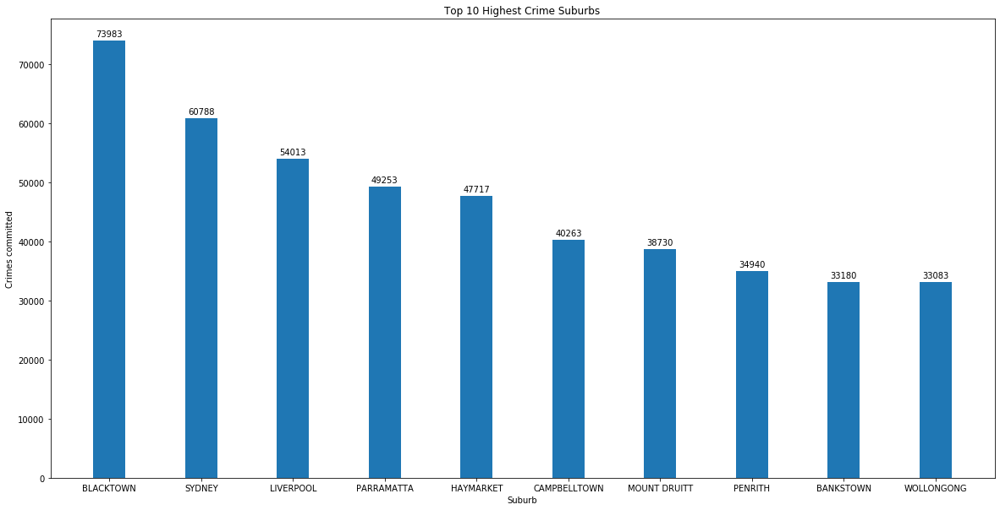

In [12]:
topNBarPlot(mapdf,10,"Suburb","Crime","Top 10 Highest Crime Suburbs", ["Suburb","Crimes committed"])

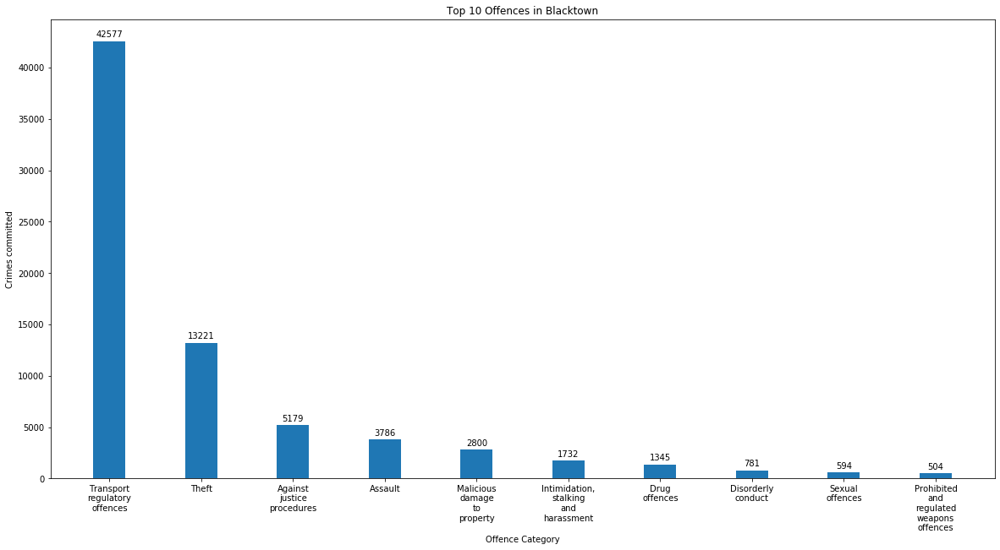

In [13]:
topNBarPlot(burb_dict["BLACKTOWN"],10,"Offence category","Crime","Top 10 Offences in Blacktown", ["Offence Category","Crimes committed"], newline = True)

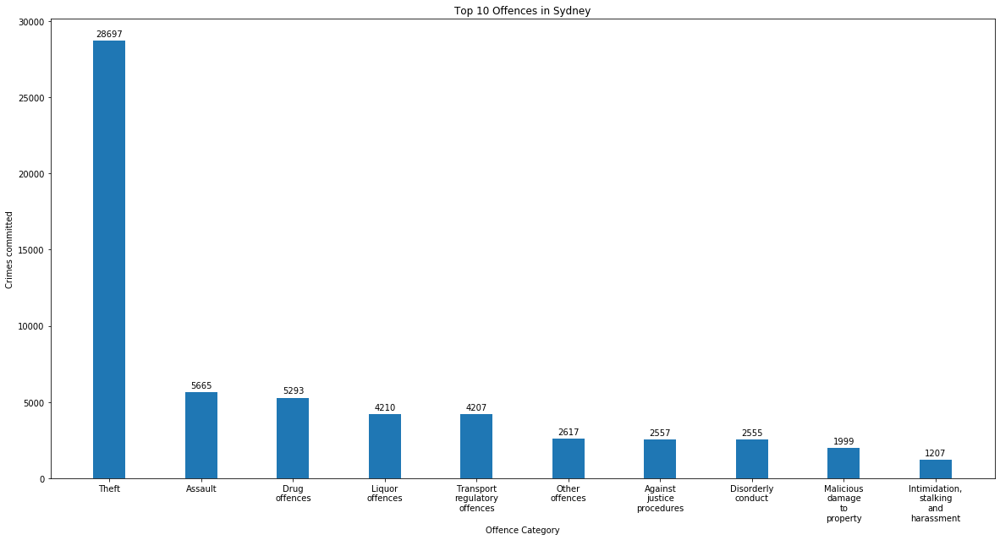

In [14]:
topNBarPlot(burb_dict["SYDNEY"],10,"Offence category","Crime","Top 10 Offences in Sydney", ["Offence Category","Crimes committed"], newline = True)

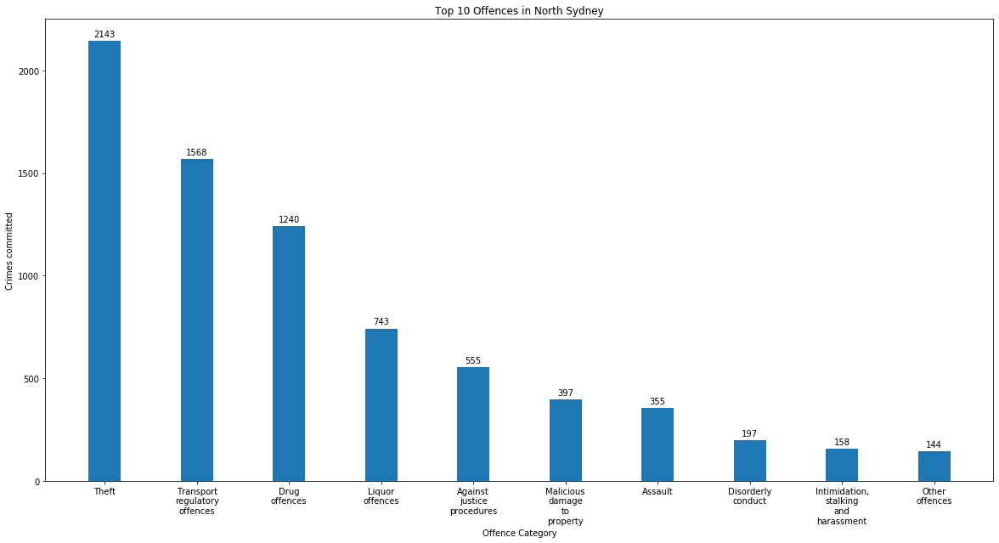

In [15]:
topNBarPlot(burb_dict["NORTH SYDNEY"],10,"Offence category","Crime","Top 10 Offences in North Sydney", ["Offence Category","Crimes committed"], newline = True)

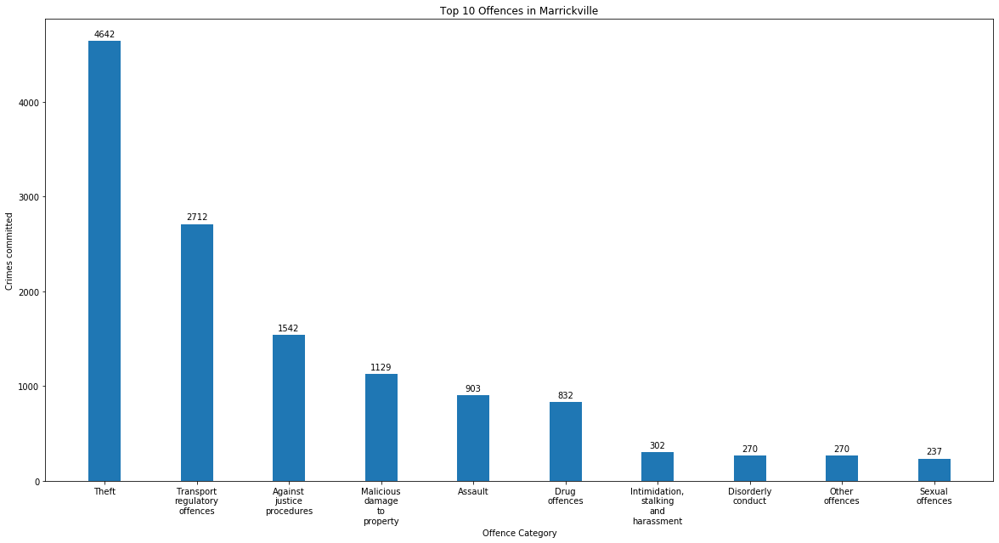

In [16]:
topNBarPlot(burb_dict["MARRICKVILLE"],10,"Offence category","Crime","Top 10 Offences in Marrickville", ["Offence Category","Crimes committed"], newline = True)

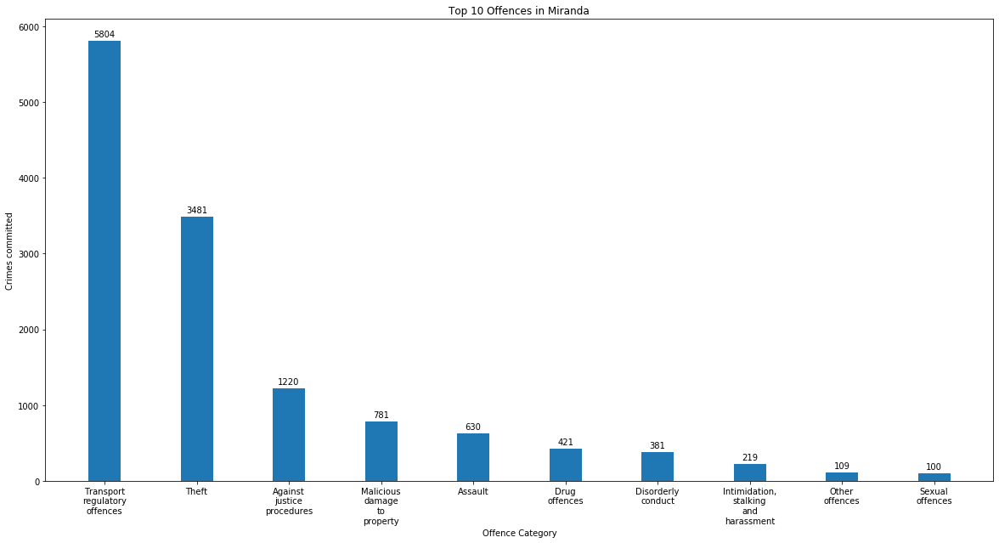

In [17]:
topNBarPlot(burb_dict["MIRANDA"],10,"Offence category","Crime","Top 10 Offences in Miranda", ["Offence Category","Crimes committed"], newline = True)

## Plan:
- [x] Delete all data before 2014
- [x] Combine each subcategory into their offence category
- [x] Look at trends of crime per suburbs
- [ ] Look at trends of crime around the year
- [ ] Look at whether location also affects offence category

In [18]:
monthlist = ["Jan", "Feb","Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
stats_dict = {}
mylist = []
fig_dict = {}
count = 2014
stats = crimedf.groupby(["Offence category"]).sum()
strip = lambda x:x[:3]
stats.columns = list(map(strip,stats.columns))
stats.rename(columns = {"Cri":"Crime"},inplace = True)

for i in range(0,60,12):
    stats_dict[count] = stats.iloc[:,i:i+12].T
    mylist.append(stats_dict[count])
    count += 1
    
for i in range(2014,2019):
    fig_dict[i] = stats_dict[i].sum(axis = 0).tolist()
    
crimes = stats.index.tolist()
stats.head(5)

,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,...,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,Crime
Offence category,,,,,,,,,,,,,,,,,,,,,
Abduction and kidnapping,28,31,32,19,27,23,21,14,25,17,...,19,14,16,15,12,19,16,17,19,1190
Against justice procedures,4803,4196,4894,4321,4293,4075,4075,4656,3949,4600,...,5371,5233,5043,4859,5134,5179,5487,5478,6282,307292
Arson,569,417,457,399,422,398,493,508,492,481,...,393,422,363,508,549,499,422,382,367,27469
Assault,5956,5117,5841,4908,5049,4543,4548,4815,4956,5450,...,5002,4765,4693,4562,4823,5004,5140,5411,6229,310685
Betting and gaming offences,9,7,11,6,11,19,7,2,9,16,...,13,21,2,12,6,10,4,6,28,559


In [19]:
def plot_clustered_stacked(dfall, xylabel, labels=None, title="multiple stacked bar plot",  H="/", **kwargs):
    n_df = len(dfall)
    n_col = len(dfall[0].columns) 
    n_ind = len(dfall[0].index)
    axe = plt.subplot(111)

    for df in dfall : # for each data frame
        axe = df.plot(kind="bar",
                      linewidth=0,
                      stacked=True,
                      ax=axe,
                      legend=False,
                      grid=False,
                      **kwargs)  # make bar plots
        
    
    h,l = axe.get_legend_handles_labels() # get the handles we want to modify
    for i in range(0, n_df * n_col, n_col): # len(h) = n_col * n_df
        for j, pa in enumerate(h[i:i+n_col]):
            for rect in pa.patches: # for each index
                rect.set_x(rect.get_x() + 1 / float(n_df + 1) * i / float(n_col))
                rect.set_hatch(H * int(i / n_col)) #edited part     
                rect.set_width(1 / float(n_df + 1))

    axe.set_xticks((np.arange(0, 2 * n_ind, 2) + 1 / float(n_df + 1)) / 2.)
    axe.set_xticklabels(df.index, rotation = 0)
    axe.set_title(title)
    
    plt.xlabel(xylabel[0])
    plt.ylabel(xylabel[1])

    # Add invisible data to add another legend
    n=[]        
    for i in range(n_df):
        n.append(axe.bar(0, 0, color="gray", hatch=H * i))

    l1 = axe.legend(h[:n_col], l[:n_col], loc=[1.01, 0.5])
    if labels is not None:
        l2 = plt.legend(n, labels, loc=[1.01, 0.1]) 
    axe.add_artist(l1)
    return axe

#modified from reference
#REFERENCES: https://stackoverflow.com/questions/22787209/how-to-have-clusters-of-stacked-bars-with-python-pandas by user: jrjc

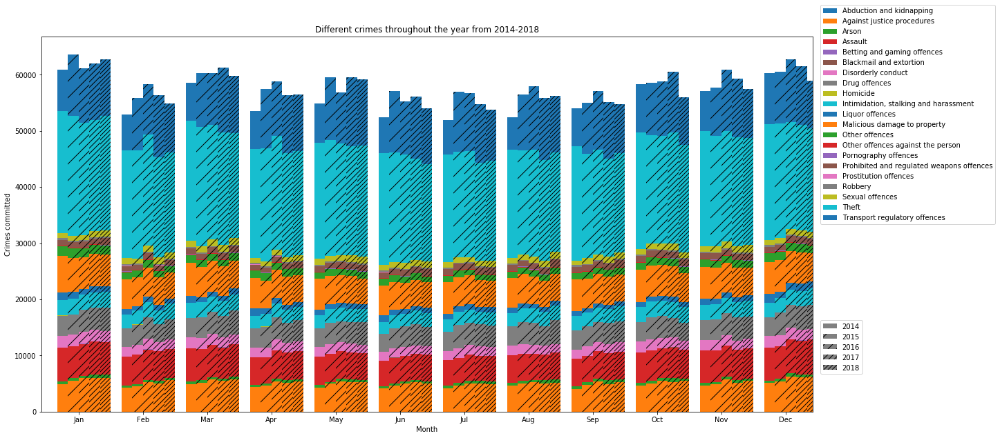

In [20]:
plot_clustered_stacked(
    mylist,labels = [2014, 2015, 2016,2017,2018],
    title = "Different crimes throughout the year from 2014-2018",
    xylabel = ["Month","Crimes committed"]
)

## Plan:
- [x] Delete all data before 2013
- [x] Combine each subcategory into their offence category
- [x] Look at trends of crime per suburbs
- [x] Look at trends of crime around the year
- [ ] Look at whether location also affects offence category

In [21]:
burbs = burbs.sort_values("Suburb")
burbs.reset_index(inplace = True,drop = True)
burbs["Crime"] =  0
burbs.head(5)

,Suburb,geometry,Crime
0,AARONS PASS,"POLYGON ((149.79499168465 -32.82275293285, 149...",0
1,ABBOTSBURY,"POLYGON ((150.87268323253 -33.86043554974, 150...",0
2,ABBOTSFORD,"POLYGON ((151.13009496476 -33.84374684244, 151...",0
3,ABERCROMBIE,"POLYGON ((149.54814187814 -33.38401597984, 149...",0
4,ABERCROMBIE RIVER,"POLYGON ((149.36929543979 -33.83099824349, 149...",0


All was going well, I just needed to load the data into the burbs dataset as a column per suburb per month per year per crime category.

..until

I figured out I can't just match the suburb names given by Government Data Base (GOV) and those for crime statistics per suburbs given by Bureau of Crime Statistic And Research(BOCSAR).

so I wanted to see the differences between the two lists.

I found out the GOV suburb polygon has repeated suburb names eg: Alison, Alison
whereas, BOCSAR has an identifier for repeated suburb names eg: Alison (Central Coast), Alison (Dungog)

|Suburb        | Crime         |
|:------------ | :------------- |
|Alison        | Alison (Central Coast) |
|Alison | Alison (Dungog) |
|Back Creek | BACK CREEK (BLAND) |
|Back Creek | BACK CREEK (GWYDIR) |
|Back Creek | BACK CREEK (MID-COAST) |

In [22]:
suburb_list = burbs["Suburb"].tolist()
suburb_list.sort()
a = set(suburb_list)

other_list = mapdf["Suburb"].tolist()
other_list = [x.upper() for x in other_list]
b = set(other_list)

same = list(b&a)
same.sort()
diff = list(b-a)
diff.sort()
diff = [i for i in diff if "(" in i]

In [23]:
burbs["Crime"] =  0
diffcopy = diff
mapdf.set_index("Suburb",inplace = True)

for idx,row in burbs.iterrows():
    if row["Suburb"] in diffcopy[0]:
        temp = diffcopy.pop(0)
        burbs.at[idx,'Crime'] = mapdf.loc[temp,"Crime"]

burbs.set_index("Suburb",inplace = True)

for i in same:
    burbs.loc[i,"Crime"] = mapdf.loc[i,"Crime"]
#       print(row["Total Crime"])    
        
mapdf.reset_index(inplace = True)
burbs.reset_index(inplace = True)

In [25]:
def add_centroid(row):
    return row.geometry.centroid

In [26]:
geo = burbs.nlargest(500,"Crime")
geo.sort_values(by ="Suburb")
geo.reset_index(inplace = True,drop = True)

geo["centroid"] = geo.apply(add_centroid, axis=1)

geo

,Suburb,geometry,Crime,centroid
0,BLACKTOWN,"POLYGON ((150.92631346865 -33.75072151073, 150...",73983,POINT (150.9034842596718 -33.77378949400838)
1,SYDNEY,"POLYGON ((151.21566791259 -33.8561913563, 151....",60788,POINT (151.2093318937477 -33.86885141291842)
2,LIVERPOOL,"POLYGON ((150.91795479953 -33.90466979603, 150...",54013,POINT (150.9158603670635 -33.92363694818464)
3,PARRAMATTA,"POLYGON ((151.00510015491 -33.80452056549, 151...",49253,POINT (151.006876845708 -33.81396454901601)
4,HAYMARKET,"POLYGON ((151.20393558692 -33.87760841951, 151...",47717,POINT (151.205007261627 -33.88096124721346)
...,...,...,...,...
495,HAMLYN TERRACE,"POLYGON ((151.48361921437 -33.2612007527, 151....",1512,POINT (151.4708707683324 -33.25408897255714)
496,WOOLLAHRA,"POLYGON ((151.24393231794 -33.88083348016, 151...",1508,POINT (151.2437907905973 -33.88692235846661)
497,HAZELBROOK,"POLYGON ((150.475560022845 -33.701096120827, 1...",1498,POINT (150.4557156168032 -33.72855599301505)
498,WATANOBBI,"POLYGON ((151.43153643904 -33.26127451729, 151...",1489,POINT (151.4258827829078 -33.26742286614311)


In [27]:
topN = geo.nlargest(20,"Crime")[["Suburb","centroid","Crime"]]
topN["offence"] = None
for i in topN["Suburb"].tolist():
    topN.loc[topN["Suburb"] == i,"offence"] = burb_dict[i].nlargest(1,"Crime").iat[0,1]


In [28]:
ordinal = lambda n: "%d%s" % (n,"tsnrhtdd"[(n/10%10!=1)*(n%10<4)*n%10::4])

In [29]:
import folium

m = folium.Map(
                location=[-33.908126, 151.050579],
                zoom_start=10
                )

bins = list(geo['Crime'].quantile([0, 0.25, 0.5, 0.75, 1]))

for i in range(len(topN)):
    folium.Marker(
        location = [topN.iloc[i,1].y, topN.iloc[i,1].x], 
        popup='%s \n\nRanking: \n%s\n\n Offence: \n%s'%(topN.iloc[i,0],ordinal(i),topN.iloc[i,3]), 
        tooltip="Click me for info!",
        icon = folium.Icon(color = "blue")
        ).add_to(m)
    
folium.Choropleth(
    geo_data = geo[["Suburb","geometry"]].to_json(),
    name = "Choropleth",
    data=geo,
    key_on='feature.properties.Suburb',
    columns=["Suburb", 'Crime'],
    fill_color='PuRd',
    bins=bins,
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Crime Rate Total across 2014-2018'
).add_to(m)

folium.LayerControl().add_to(m)

In [31]:
m